In [1]:
import numpy as np
import pandas as pd
import re

In [2]:
pd.set_option('display.max_colwidth',None)
pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns', None)

In [3]:
df = pd.read_csv('data_cleaned_after_lvl3.csv')

In [4]:
df.sample(5)

,society,property_type,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features
1674,m3m woodshire,flat,sector 107,1.30,10815.0,1202.0,Super Built up area 1943(180.51 sq.m.)Carpet area: 1202 sq.ft. (111.67 sq.m.),3,3,3,pooja room,7.0,NaN,1 to 5 Year Old,"['Signum 107', 'Nora Solomon Medicenter', 'Indira Gandhi International Airport', 'The Shikshiyan School', 'Najafgarh Jheel Bird Sanctuary', 'Skylark Cricket Academy']",NaN,"['Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Separate entry for servant room', 'Piped-gas', 'Swimming Pool', 'Park', 'Security Personnel', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']"
1942,independent,house,sector 82,7.50,23148.0,3240.0,Plot area 360(301.01 sq.m.),5,5,3+,"pooja room,servant room",2.0,East,1 to 5 Year Old,"['Orris Community Center', 'Petrol Pump Indian Oil', 'Essar Petrol Pump', 'Petrol Pump Indian Oil', 'Petrol Pump', 'Indian Oil', 'HP Petrol Pump', 'Vijay Petrol Pump', 'KFC', 'Pizza Hut', 'Rao Dhaba', ""McDonald's""]","['1 Water Purifier', '12 Fan', '1 Exhaust Fan', '4 Geyser', '25 Light', '8 AC', '1 Chimney', '1 Curtains', '1 Modular Kitchen', '5 Wardrobe', 'No Bed', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine']","['Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Centrally Air Conditioned', 'Water purifier', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'Recently Renovated', 'Piped-gas', 'Visitor Parking', 'Park', 'Natural Light', 'Internet/wi-fi connectivity', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting']"
2121,tulip violet,flat,sector 69,1.55,9822.0,1578.0,Super Built up area 1578(146.6 sq.m.),3,3,2,pooja room,9.0,North-East,1 to 5 Year Old,"['Airia Mall Sector 68', 'Southern Peripheral Road', 'Golf Course Extension Rd', 'Imperio School', 'DPG Institute of Technology', 'Ektaa Hospitals', 'Indira Gandhi International Airport', 'Vipul Trade Business Centre', 'Radisson Hotel Gurugram', 'SkyJumper Trampoline Park']","['3 Wardrobe', '5 Fan', '1 Exhaust Fan', '2 Geyser', '15 Light', '4 AC', '1 Curtains', '1 Chimney', '1 Modular Kitchen', 'No Bed', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Power Back-up', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']"
2928,tarc maceo,flat,sector 91,1.40,7407.0,1890.0,Super Built up area 1890(175.59 sq.m.)Built Up area: 1700 sq.ft. (157.94 sq.m.)Carpet area: 1600 sq.ft. (148.64 sq.m.),3,3,3+,not available,7.0,North,1 to 5 Year Old,"['Manish Gallexie 91', 'Dwarka Expressway', 'Rao Bharat Singh International School', 'Dronacharya College of Engineering', 'Silver Streak Multi Speciality Hospital', 'Indira Gandhi International Airport', 'IMT Manesar', 'Holiday Inn Sector 90', 'Manesar Golf Course', 'National Tennis Academy']",NaN,"['Security / Fire Alarm', 'Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'Swimming Pool', 'Water Storage', 'Park', 'Visitor Parking', 'Security Person

In [5]:
# 1. Feature engineering on areaWithType column

df[['areaWithType','area']].sample(20)

,areaWithType,area
178,Built Up area: 1990 (184.88 sq.m.),1990.0
344,Super Built up area 1100(102.19 sq.m.),1100.0
3296,Plot area 900(83.61 sq.m.),945.0
2602,Super Built up area 1828(169.83 sq.m.),1969.0
668,Super Built up area 1485(137.96 sq.m.),1485.0
3044,Super Built up area 1430(132.85 sq.m.),1428.0
1396,Super Built up area 1860(172.8 sq.m.)Built Up area: 1600 sq.ft. (148.64 sq.m.)Carpet area: 1400 sq.ft. (130.06 sq.m.),1860.0
3543,Super Built up area 1360(126.35 sq.m.),1360.0
2697,Super Built up area 2010(186.74 sq.m.)Carpet area: 1610 sq.ft. (149.57 sq.m.),2010.0
1627,Super Built up area 2095(194.63 sq.m.)Built Up area: 1860 sq.ft. (172.8 sq.m.),2095.0


In [6]:
# Function to Extract Super Built up area from areaWithType Column

def get_super_built_up_area(text):
    match = re.search(r'Super Built up area (\d+\.?\d*)', text)
    if match:
        return float(match.group(1))
    return None 

In [7]:
# Function to extract the Built up area or Carpet area
# Built up or carpet area v input me lelenge ki kon sa separate krna hai

def get_area(text, area_type):
    match = re.search(area_type + r'\s*:\s*(\d+\.?\d*)', text)
    if match:
        return float(match.group(1))
    return None
        

In [8]:
# Function to check if area is provided in sq. m. and convert into sq.ft. if needed
def convert_to_sqft(text, area_value):
    if area_value is None:
        return None
    match = re.search(r'{} \((\d+\.?\d*) sq.m.\)'.format(area_value), text)
    if match:
        sq_m_value = float(match.group(1))
        return sq_m_value * 10.7639  
    return area_value   

In [9]:
# Extracting Super built up area and converting to sqft if needed
df['super_built_up_area'] = df['areaWithType'].apply(get_super_built_up_area)
df['super_built_up_area'] = df.apply(lambda x: convert_to_sqft(x['areaWithType'], x['super_built_up_area']), axis=1)

In [10]:
# Extracting Built up area and converting to sqft if needed
df['built_up_area'] = df['areaWithType'].apply(lambda x: get_area(x, 'Built Up area'))
df['built_up_area'] = df.apply(lambda x: convert_to_sqft(x['areaWithType'], x['built_up_area']), axis=1)

In [11]:
# Extracting Carpet area and converting to sqft if needed
df['carpet_area'] = df['areaWithType'].apply(lambda x: get_area(x, 'Carpet area'))
df['carpet_area'] = df.apply(lambda x: convert_to_sqft(x['areaWithType'], x['carpet_area']), axis=1)

In [12]:
df.sample(5)

,society,property_type,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area
183,vatika gurgaon,flat,sector 83,0.87,6987.0,1245.0,Super Built up area 1245(115.66 sq.m.),2,2,2,not available,3.0,East,5 to 10 Year Old,"['Huda Metro Station (Gurugram)', 'Sapphire 83 Mall', 'Vatika Sector Road', 'Gurgaon - Delhi Expy', 'Dwarka Expy', 'Euro International School, Sec 84', 'DPG Degree College', 'Aarvy Healthcare Super Speciality', 'Indira Gandhi Intl Airport', 'Garhi Harsaru Junction']","['3 Fan', '1 Geyser', '5 Light', '5 Curtains', 'No AC', 'No Bed', 'No Chimney', 'No Dining Table', 'No Exhaust Fan', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Feng Shui / Vaastu Compliant', 'Security / Fire Alarm', 'Lift(s)', 'Maintenance Staff', 'Water Storage', 'Park']",1245.0,NaN,NaN
3423,independent,house,sector 26,5.80,12837.0,4518.0,Plot area 502(419.74 sq.m.),4,4,3+,not available,4.0,NaN,10+ Year Old,"['Guru dronacharya metro station', 'Sikandarpur rmrg metro station', 'Sikanderpur metro station', 'Sikandarpur metro station', 'Dlf phase 1 metro station', 'Dlf phase 2 metro station', 'Hanuman Mandir', 'Shri Shiv Shakthi Mandir', 'Icici bank ATM', 'Axis bank ATM', 'Icici bank ATM', 'Central bank atm teste 001112', 'Central bank ATM', 'Anahat Hospital', 'Sikka Maternity And Surgical Center', ""St Stephen's Hospital Health Care Facility"", 'Divine Look Clinic Centre 1', 'Krishna Family Clinic', 'Durga Poly Clinic', 'Upkar Clinic', 'The Dental Lounge', 'Marwah Clinic', 'Cosmodentz Dental Clinic', ""Dr. Khullar's Dental Clinic"", 'Dental Cure and Care Centre', 'Kailash Nursing Home Gurgaon', 'Surgi Center Clinic', 'Shri Ram Memorial Hospital', 'R.N Clinic', 'Relief Physiotherapy Clinic', 'Garg Dental Care', 'RBS Dental Clinic', 'Uma Sanjeevani Health Centre And Hospital', 'Lord Krishna Hospital', 'Darpan Skin & Mind Clinic', 'Pharmacy', 'Religare Wellness', '98.4', 'Guardian', 'Emaar Business Park', 'Axis bank', 'State bank of india', 'Hsbc bank', 'Kotak mahindra bank', 'PVR Cinames', 'Food Court']",[],"['Private Garden / Terrace', 'Maintenance Staff', 'Park', 'Bank Attached Property', 'Fitness Centre / GYM', 'Rain Water Harvesting']",NaN,NaN,NaN
3272,prime habitat,flat,sector 99a,0.27,5432.0,497.0,Carpet area: 497 (46.17 sq.m.),2,2,1,not available,4.0,North-East,0 to 1 Year Old,"['The Hive Mall', 'Omaxe Gurgaon Mall', 'Gurugram Road', 'Dwarka Expy', 'Euro International School', 'Shri Balaji’s Multispeciality Hospital', 'Indira Gandhi Intl Airport', 'Garhi Harsaru Junction']",[],['Visitor Parking'],NaN,NaN,497.0
102,m3m golfestate,flat,sector 65,5.40,18126.0,2979.0,Super Built up area 2979(276.76 sq.m.),3,4,3,"study room,servant room",19.0,North-East,5 to 10 Year Old,"['Sector 54 Chowk Metro Station', 'Sahara Mall', 'NH 248A', 'Shiksha Bharti Public School', 'Gurugram University', 'Park Hospital', 'Indira Gandhi International Airport', 'Garhi Harsaru Junction', 'Holiday Inn Express Gurugram']","['4 Wardrobe', '7 Fan', '1 Exhaust Fan', '5 Geyser', '1 Stove', '11 Light', '1 Chimney', '1 Modular Kitchen', '6 AC', '1 Curtains', 'No Bed', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Power Back-up', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Wast

In [13]:
# Checking which flats has all three area values

df[~((df['super_built_up_area'].isnull()) | (df['built_up_area'].isnull()) | (df['carpet_area'].isnull()))][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']]

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
0,1.20,flat,1034.0,Super Built up area 1665(154.68 sq.m.)Built Up area: 1145 sq.ft. (106.37 sq.m.)Carpet area: 1034 sq.ft. (96.06 sq.m.),1665.0,1145.00,1034.00
28,1.88,flat,2727.0,Super Built up area 2727(253.35 sq.m.)Built Up area: 2726 sq.ft. (253.25 sq.m.)Carpet area: 2725 sq.ft. (253.16 sq.m.),2727.0,2726.00,2725.00
31,2.35,flat,2069.0,Super Built up area 2069(192.22 sq.m.)Built Up area: 1900 sq.ft. (176.52 sq.m.)Carpet area: 1800 sq.ft. (167.23 sq.m.),2069.0,1900.00,1800.00
34,2.35,flat,2217.0,Super Built up area 2217(205.97 sq.m.)Built Up area: 2210 sq.ft. (205.32 sq.m.)Carpet area: 1720 sq.ft. (159.79 sq.m.),2217.0,2210.00,1720.00
35,0.75,flat,1050.0,Super Built up area 1326(123.19 sq.m.)Built Up area: 1298 sq.ft. (120.59 sq.m.)Carpet area: 1050 sq.ft. (97.55 sq.m.),1326.0,1298.00,1050.00
37,0.95,flat,2235.0,Super Built up area 2000(185.81 sq.m.)Built Up area: 1983 sq.ft. (184.23 sq.m.)Carpet area: 1900 sq.ft. (176.52 sq.m.),2000.0,1983.00,1900.00
42,1.12,flat,1736.0,Super Built up area 1741(161.74 sq.m.)Built Up area: 1485 sq.ft. (137.96 sq.m.)Carpet area: 1335 sq.ft. (124.03 sq.m.),1741.0,1485.00,1335.00
43,1.78,flat,2215.0,Super Built up area 2215(205.78 sq.m.)Built Up area: 2000 sq.ft. (185.81 sq.m.)Carpet area: 1650 sq.ft. (153.29 sq.m.),2215.0,2000.00,1650.00
45,0.37,flat,500.0,Super Built up area 500(46.45 sq.m.)Built Up area: 425 sq.ft. (39.48 sq.m.)Carpet area: 366.48 sq.ft. (34.05 sq.m.),500.0,425.00,366.48
81,2.20,flat,1968.0,Super Built up area 2812(261.24 sq.m.)Built Up area: 2390 sq.ft. (222.04 sq.m.)Carpet area: 1968 sq.ft. (182.83 sq.m.),2812.0,2390.00,1968.00


In [14]:
# Checking which flats has all three area values so that we can fill missing values using them

df[~((df['super_built_up_area'].isnull()) | (df['built_up_area'].isnull()) | (df['carpet_area'].isnull()))][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].shape

(534, 7)

In [16]:
# Extracting rows which have plot area

df[df['areaWithType'].str.contains('Plot')][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].sample(5)

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
3373,3.49,house,1728.0,Plot area 192(160.54 sq.m.),NaN,NaN,NaN
770,5.88,house,2160.0,Plot area 240(200.67 sq.m.),NaN,NaN,NaN
2704,9.35,house,3240.0,Plot area 3240(301.01 sq.m.)Built Up area: 7500 sq.ft. (696.77 sq.m.)Carpet area: 6000 sq.ft. (557.42 sq.m.),NaN,7500.0,6000.0
2778,5.65,house,2367.0,Plot area 263(219.9 sq.m.),NaN,NaN,NaN
2352,9.50,house,546.0,Plot area 546(50.73 sq.m.),NaN,NaN,NaN


In [17]:
# checking missing values
df.isnull().sum()

society                   1
property_type             0
sector                    0
price                    18
price_per_sqft           18
area                     18
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
additionalRoom            0
floorNum                 19
facing                 1105
agePossession             1
nearbyLocations         177
furnishDetails          981
features                635
super_built_up_area    1888
built_up_area          2616
carpet_area            1859
dtype: int64

In [18]:
# Extracting those rows where all three area values are not available
all_nan_df = df[((df['super_built_up_area'].isnull()) & (df['built_up_area'].isnull()) & (df['carpet_area'].isnull()))][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']]

In [19]:
# Extracting the index of rows where all three informations are missing
all_nan_index = df[((df['super_built_up_area'].isnull()) & (df['built_up_area'].isnull()) & (df['carpet_area'].isnull()))][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].index

In [20]:
# observation -> all three values are missing in those rows where plot area info is given
all_nan_df.sample(2)

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
502,5.5,house,1000.0,Plot area 1000(92.9 sq.m.),NaN,NaN,NaN
1774,13.5,house,4518.0,Plot area 502(419.74 sq.m.),NaN,NaN,NaN


In [21]:
all_nan_index

Index([  16,   19,   32,   36,   39,   53,   55,   56,   59,   60,
       ...
       3724, 3732, 3737, 3749, 3750, 3757, 3776, 3778, 3789, 3793],
      dtype='int64', length=546)

In [22]:
# Function for extracting plot area from 'areaWithType' column
# Houses ke case me plot area is similar to flat ke case me built up area so will update in built up column
def extract_plot_area(area_with_type):
    match = re.search(r'Plot area (\d+\.?\d*)',area_with_type)
    return float(match.group(1)) if match else None

In [23]:
all_nan_df['built_up_area'] = all_nan_df['areaWithType'].apply(extract_plot_area)

In [24]:
all_nan_df

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
16,6.50,house,1800.0,Plot area 200(167.23 sq.m.),NaN,200.00,NaN
19,11.29,house,3240.0,Plot area 360(301.01 sq.m.),NaN,360.00,NaN
32,12.50,house,2430.0,Plot area 270(225.75 sq.m.),NaN,270.00,NaN
36,1.55,house,1053.0,Plot area 117(97.83 sq.m.),NaN,117.00,NaN
39,0.60,house,558.0,Plot area 62(51.84 sq.m.),NaN,62.00,NaN
53,4.45,house,1350.0,Plot area 150(125.42 sq.m.),NaN,150.00,NaN
55,2.00,house,1337.0,Plot area 1337.4(124.25 sq.m.),NaN,1337.40,NaN
56,0.50,house,540.0,Plot area 540(50.17 sq.m.),NaN,540.00,NaN
59,27.50,house,11286.0,Plot area 1254(1048.5 sq.m.),NaN,1254.00,NaN
60,1.95,house,920.0,Plot area 920(85.47 sq.m.),NaN,920.00,NaN


In [353]:
# 9 sq yard = 1 sqft
# 10.7639 sq.m. = 1 sqft
# Observation-> area scale is varying in plot area case of built up column and area column
# multiplying 9 give area so that built up area is in sq yards

# changing to sqft
def convert_scale(row):
    if np.isnan(row['area']) or np.isnan(row['built_up_area']):
        return row['built_up_area']
    else:
        if round(row['area']/row['built_up_area']) == 9.0:
            return row['built_up_area']*9
        elif round(row['area']/row['built_up_area']) == 11.0:
            return row['built_up_area']*10.7639
        else:
            return row['built_up_area'] 


In [354]:
all_nan_df['built_up_area'] = all_nan_df.apply(convert_scale,axis=1)

In [355]:
all_nan_df

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
16,6.50,house,1800.0,Plot area 200(167.23 sq.m.),NaN,1800.0000,NaN
19,11.29,house,3240.0,Plot area 360(301.01 sq.m.),NaN,3240.0000,NaN
32,12.50,house,2430.0,Plot area 270(225.75 sq.m.),NaN,2430.0000,NaN
36,1.55,house,1053.0,Plot area 117(97.83 sq.m.),NaN,1053.0000,NaN
39,0.60,house,558.0,Plot area 62(51.84 sq.m.),NaN,558.0000,NaN
53,4.45,house,1350.0,Plot area 150(125.42 sq.m.),NaN,1350.0000,NaN
55,2.00,house,1337.0,Plot area 1337.4(124.25 sq.m.),NaN,1337.4000,NaN
56,0.50,house,540.0,Plot area 540(50.17 sq.m.),NaN,540.0000,NaN
59,27.50,house,11286.0,Plot area 1254(1048.5 sq.m.),NaN,11286.0000,NaN
60,1.95,house,920.0,Plot area 920(85.47 sq.m.),NaN,920.0000,NaN


In [356]:
# Updating the original dataframe

df.update(all_nan_df)

In [357]:
df.isnull().sum()

society                   1
property_type             0
sector                    0
price                    18
price_per_sqft           18
area                     18
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
additionalRoom            0
floorNum                 19
facing                 1105
agePossession             1
nearbyLocations         177
furnishDetails          981
features                635
super_built_up_area    1888
built_up_area          2070
carpet_area            1859
dtype: int64

In [358]:
# ADDITIONAL ROOM COLUMN

In [359]:
df.sample(5)

,society,property_type,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area
2367,bestech park view sanskruti,flat,sector 92,1.90,8172.0,2325.0,Super Built up area 2325(216 sq.m.)Built Up area: 1920 sq.ft. (178.37 sq.m.)Carpet area: 1750 sq.ft. (162.58 sq.m.),4,4,3+,"pooja room,study room,servant room,others",10.0,West,1 to 5 Year Old,"['Sapphire 93 Mall', 'Dwarka Expressway', 'NH-8, Imt Manesar', 'Western Peripheral Expressway', 'RPS International School Sector 89', 'DPG Institute of Technology', 'Aarvy Healthcare Hospital', 'Indira Gandhi International Airport', 'Holiday Inn Sector 90', 'De Adventure Park', 'National Tennis Academy Sector 98']","['7 Light', '6 AC', '1 Modular Kitchen', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Feng Shui / Vaastu Compliant', 'Security / Fire Alarm', 'Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'Water Storage', 'Park', 'Visitor Parking']",2325.0,1920.0,1750.0
2701,dlf the ultima,flat,sector 81,2.20,10476.0,2100.0,Super Built up area 2100(195.1 sq.m.),3,4,3+,servant room,17.0,East,1 to 5 Year Old,"['Huda Metro Station (Gurugram)', 'Vatika Town Square-INXT', 'Manesar Road', 'NH 48', 'Euro International School, Sec 84', 'SGT University', 'Miracles Apollo Cradle Hospital', 'Indira Gandhi Intl Airport', 'Garhi Harsaru Junction']","['1 Water Purifier', '4 Fan', '1 Fridge', '1 Exhaust Fan', '3 Geyser', '1 Stove', '8 Light', '5 AC', '1 Chimney', '4 Curtains', '1 Modular Kitchen', '3 Wardrobe', '1 Microwave', '1 Washing Machine', 'No Bed', 'No Dining Table', 'No Sofa', 'No TV']","['Feng Shui / Vaastu Compliant', 'Security / Fire Alarm', 'Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'Water Storage', 'Park', 'Visitor Parking']",2100.0,NaN,NaN
1292,signature global park,flat,sohna road road,0.65,5637.0,1153.0,Super Built up area 1153(107.12 sq.m.),2,2,2,pooja room,2.0,North-West,1 to 5 Year Old,"['Sector 55-56 metro', 'Global city centre', 'Sohna road dhunela', 'Gd goenka university', 'Maharana pratap school', 'Vardaan hospital and trauma centre', 'Indira Gandhi International Airport', 'Garhi harsaru railway station Gurgaon']",NaN,"['Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Internet/wi-fi connectivity', 'Low Density Society', 'Shopping Centre', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",1153.0,NaN,NaN
3344,dlf new town heights,house,sector 91,2.50,7058.0,3542.0,Plot area 3400(315.87 sq.m.),4,4,3+,"pooja room,study room,servant room,store room",3.0,East,5 to 10 Year Old,"['MG Road Metro Station', 'RHM Public School', 'Sanjeevani Hospital', 'IGI Airport', 'Garhi Harsaru Junction', 'Spaze Business Park', 'Orchid Business Park', 'KLAY Play School']","['2 Bed', '7 Wardrobe', '9 Fan', '1 Exhaust Fan', '3 Geyser', '14 Light', '2 AC', '1 Modular Kitchen', '1 Chimney', 'No Curtains', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Feng Shui / Vaastu Compliant', 'Maintenance Staff', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Low Density Society', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center']",NaN,3400.0,NaN
2758,independent,house,sector 11,1.20,4444.0,2700.0,Built Up area: 300 (250.84 sq.m.),7,3

In [360]:
df['additionalRoom'].value_counts()

additionalRoom
not available                                    1587
servant room                                      705
study room                                        250
others                                            225
pooja room                                        165
store room                                         99
study room,servant room                            99
pooja room,servant room                            82
pooja room,study room,servant room,store room      72
servant room,others                                60
pooja room,study room,servant room                 55
pooja room,study room,servant room,others          54
servant room,pooja room                            38
servant room,store room                            33
study room,others                                  29
pooja room,study room                              22
pooja room,others                                  17
pooja room,store room                              15
servant room,

In [361]:
# Extracting separate rooms column from additionalRoom column 
# Ex - pujaroom column, servant room column etc

new_cols = ['study room','servant room','store room','puja room','others']

In [362]:
# addinng columns and 0 or 1 in their value
for col in new_cols:
    df[col] = df['additionalRoom'].str.contains(col).astype(int)

In [363]:
df[new_cols]

,study room,servant room,store room,puja room,others
0,1,0,0,0,0
1,0,1,0,0,0
2,0,0,0,0,0
3,0,0,0,0,0
4,0,1,0,0,0
5,0,0,0,0,0
6,0,0,0,0,0
7,0,0,0,0,0
8,0,0,0,0,0
9,0,1,0,0,0


In [364]:
# AGEPOSSESION Column

In [365]:
df['agePossession'].value_counts()

agePossession
1 to 5 Year Old       1676
5 to 10 Year Old       575
0 to 1 Year Old        530
undefined              332
10+ Year Old           310
Under Construction      90
Within 6 months         70
Within 3 months         26
Dec 2023                22
By 2023                 19
By 2024                 17
Dec 2024                16
Mar 2024                14
Jan 2024                 8
Oct 2024                 8
Jun 2024                 7
Dec 2025                 7
Aug 2023                 7
Nov 2023                 5
Aug 2024                 4
By 2025                  4
Oct 2023                 4
Sep 2023                 4
Jul 2024                 4
Feb 2024                 3
Jan 2025                 3
May 2024                 3
Nov 2024                 3
Mar 2025                 2
Sep 2025                 2
Jul 2027                 2
Dec 2026                 2
Apr 2026                 2
Jan 2026                 2
By 2027                  2
Oct 2025                 2
Jul 2025      

In [366]:
# Writing function to convert this into categories
# categories are Undefined, New Property, Relatively New, Moderately old, Old, under construction

def categorize_age_possession(value):
    if pd.isna(value):
        return "Undefined"
    if "0 to 1 Year Old" in value or "Within 6 months" in value or "Within 3 months" in value:
        return "New Property"
    if "1 to 5 Year Old" in value:
        return "Relatively New"
    if "5 to 10 Year Old" in value:
        return "Moderately Old"
    if "10+ Year Old" in value:
        return "Old Property"
    if "Under Construction" in value or "By" in value:
        return "Under Construction"
    try:
        # For entries like 'May 2024'
        int(value.split(" ")[-1])
        return "Under Construction"
    except:
        return "Undefined"
    

In [367]:
df['agePossession'] = df['agePossession'].apply(categorize_age_possession)

In [368]:
df['agePossession'].value_counts()

agePossession
Relatively New        1676
New Property           626
Moderately Old         575
Undefined              333
Old Property           310
Under Construction     283
Name: count, dtype: int64

In [26]:
df.sample(5)

,society,property_type,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area
1060,emaar mgf the palm drive,flat,sector 66,3.40,15454.0,2200.0,Super Built up area 2200(204.39 sq.m.),3,4,3,"servant room,store room",9.0,East,1 to 5 Year Old,"['Sector 55-56 Rapid Metro Station', 'HUB 66', 'NH 248A', 'Hasanpur', 'Ashoka International School', 'Gurugram University', 'Park Hospital', 'Indira Gandhi International Airport', 'Sealdah', 'Vatika Business Centre', 'The Oberoi Gurgaon', 'De Adventure Park', 'DLF Golf and Country Club', 'Tau DeviLal Sports Complex']","['4 Wardrobe', '5 Fan', '1 Exhaust Fan', '5 Geyser', '1 Stove', '10 Light', '1 Modular Kitchen', '1 Chimney', 'No AC', 'No Bed', 'No Curtains', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Security / Fire Alarm', 'Power Back-up', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'Water Storage', 'Separate entry for servant room', 'Bank Attached Property', 'Piped-gas', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Shopping Centre', 'Fitness Centre / GYM', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",2200.0,NaN,NaN
3436,luxury dlf city floors,house,sector 26,20.00,48889.0,4091.0,Plot area 500(418.06 sq.m.),16,16,3+,servant room,4.0,NaN,0 to 1 Year Old,"['Sikandarpur metro station', 'Sikanderpur metro station', 'Sikandarpur rmrg metro station', 'Dlf phase 1 metro station', 'Dlf phase 2 metro station', 'Guru dronacharya metro station', 'Mg road metro station', 'Hanuman Mandir', 'Axis bank ATM', 'Icici bank ATM', 'Central bank ATM', 'Central bank atm teste 001112', 'Divine Look Clinic Centre 1', 'Sikka Maternity And Surgical Center', 'Surgi Center Clinic', 'Uma Sanjeevani Health Centre And Hospital', 'Lord Krishna Hospital', 'Durga Poly Clinic', 'Krishna Family Clinic', 'Sidhesh Hospital Gurgaon', 'Upkar Clinic', 'Cosmodentz Dental Clinic', 'Kailash Nursing Home Gurgaon', ""St Stephen's Hospital Health Care Facility"", 'Relief Physiotherapy Clinic', 'RBS Dental Clinic', 'Marwah Clinic', 'Religare Wellness', '98.4', 'Guardian', 'Emaar Business Park', 'DLF Cyber City Phase II', 'Axis bank', 'Hsbc bank', 'Kotak mahindra bank', 'Hdfc bank', 'Lord krishna bank', 'Indusind bank', 'Abn amro bank', 'PVR Cinames', 'DT Cinemas', 'PVR Metropolitan', 'PVR Cinames', 'Food Court', 'NutrioBox Gurugram', 'Pan Bangkok', 'American Montessori']","['16 Wardrobe', '26 Fan', '1 Exhaust Fan', '16 Geyser', '32 Light', '16 AC', '1 Modular Kitchen', '1 Chimney', 'No Bed', 'No Curtains', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']","['High Ceiling Height', 'Park', 'Visitor Parking', 'Fitness Centre / GYM']",NaN,NaN,NaN
1538,m3m woodshire,flat,sector 107,0.82,6002.0,1366.0,Super Built up area 1366(126.91 sq.m.),2,2,3+,not available,7.0,North-East,1 to 5 Year Old,"['Signum 107', 'Nora Solomon Medicenter', 'Indira Gandhi International Airport', 'The Shikshiyan School', 'Najafgarh Jheel Bird Sanctuary', 'Skylark Cricket Academy']",[],"['Security / Fire Alarm', 'Power Back-up', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",1366.0,NaN,NaN
2455,dlf the icon,flat,sector 43,6.00,26086.0,2300.0,Carpet area: 2300 (213.68 sq.m.),4,4,3+,servant room,18.0,North-East,10+ Year Old,"['Sector 42-43 Rapid Metro Station', 'Ardee Mall', 'NH 248A', 'Heritage Intl Xperien

In [370]:
# Furnishing details column Feature engineering
# Idea -> There are almost 15-20 fursnishing items so unsab ka separate column bana denge
# Then based on that we can use clustering algorithms to make clusters and convert into categories like 
# Furnished, semifurnished, no furnishing

In [371]:
# Extracting uniques furnishing

all_furnishing = []
for detail in df['furnishDetails'].dropna():
    furnishings = detail.replace('[','').replace(']','').replace("'","").split(', ')
    all_furnishing.extend(furnishings)

unique_furnishings = list(set(all_furnishing))

In [372]:
# Function to extract the count of resepective furnish items

def get_furnishing_count(details, furnishing):
    if isinstance(details, str):
        if f"No {furnishing}" in details:
            return 0
        pattern = re.compile(f"(\d+) {furnishing}")
        match = pattern.search(details)
        if match:
            return int(match.group(1))
        elif furnishing in details:
            return 1
    return 0

<>:7: SyntaxWarning: invalid escape sequence '\d'
<>:7: SyntaxWarning: invalid escape sequence '\d'
/var/folders/3v/pb26c2zj6_v2h3f13gtgqw3w0000gn/T/ipykernel_49399/1931820317.py:7: SyntaxWarning: invalid escape sequence '\d'
  pattern = re.compile(f"(\d+) {furnishing}")


In [373]:
# Simplify the furnishings list by removing "No" prefix and numbers
columns_to_include = [re.sub(r'No |\d+', '', furnishing).strip() for furnishing in unique_furnishings]
columns_to_include = list(set(columns_to_include))  # Get unique furnishings
columns_to_include = [furnishing for furnishing in columns_to_include if furnishing]  # Remove empty strings

# Create new columns for each unique furnishing and populate with counts
for furnishing in columns_to_include:
    df[furnishing] = df['furnishDetails'].apply(lambda x: get_furnishing_count(x, furnishing))

# Create the new dataframe with the required columns
furnishings_df = df[['furnishDetails'] + columns_to_include]

In [374]:
furnishings_df.shape

(3803, 19)

In [375]:
furnishings_df.drop(columns=['furnishDetails'],inplace=True)

/var/folders/3v/pb26c2zj6_v2h3f13gtgqw3w0000gn/T/ipykernel_49399/114705885.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  furnishings_df.drop(columns=['furnishDetails'],inplace=True)


In [376]:
furnishings_df.sample(5)

,Chimney,Microwave,Light,Washing Machine,AC,Dining Table,Fridge,Modular Kitchen,Curtains,Wardrobe,Fan,Bed,Exhaust Fan,Sofa,Geyser,Stove,Water Purifier,TV
1016,1,0,1,0,0,0,0,0,0,1,1,1,0,0,1,0,0,0
2261,0,0,10,0,0,0,0,0,0,3,5,0,0,0,4,0,0,0
3208,3,0,24,0,0,0,0,1,0,6,12,0,1,0,6,0,0,0
308,1,0,9,0,4,0,0,1,0,3,5,0,1,0,3,0,0,0
623,1,0,27,0,8,0,0,1,6,4,9,0,0,0,1,0,0,0


In [377]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [378]:
scaler = StandardScaler()

In [379]:
scaled_data = scaler.fit_transform(furnishings_df)

In [380]:
wcss_reduced = []
for i in range (1,11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(scaled_data)
    wcss_reduced.append(kmeans.inertia_)

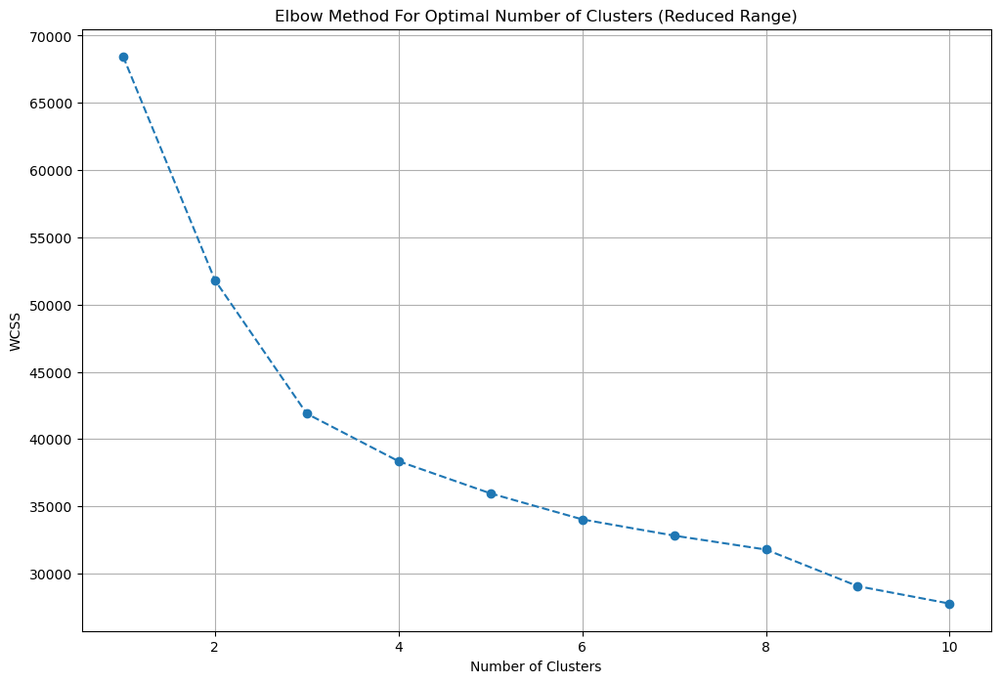

In [381]:
# Plotting the result

plt.figure(figsize = (12,8))
plt.plot(range(1,11), wcss_reduced, marker = 'o', linestyle = '--')
plt.title('Elbow Method For Optimal Number of Clusters (Reduced Range)')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

In [382]:
n_clusters = 3

# Fit KMeans model
kmeans = KMeans(n_clusters = n_clusters, random_state = 42)
kmeans.fit(scaled_data)

KMeans(n_clusters=3, random_state=42)

In [383]:
# Predict the cluster assignments for each row
cluster_assignments = kmeans.predict(scaled_data)
print(cluster_assignments)

[0 0 1 ... 0 0 0]


In [384]:
df.iloc[:,:-18]

,society,property_type,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area,study room,servant room,store room,puja room,others
0,paras dews,flat,sector 106,1.20,11605.0,1034.0,Super Built up area 1665(154.68 sq.m.)Built Up area: 1145 sq.ft. (106.37 sq.m.)Carpet area: 1034 sq.ft. (96.06 sq.m.),3,3,3,study room,12.0,North-West,Relatively New,"['MG Road Metro Station', 'NeoSquare Shopping Mall', 'Dwarka Expressway', 'Glorious World School', 'DPG Institute of Technology', 'Chirag Hospital', 'Indira Gandhi International Airport', 'Gurgaon', 'Country Inn & Suites by Radisson', 'SkyJumper Trampoline Park', 'Hamoni Golf Camp']",NaN,"['Water purifier', 'Centrally Air Conditioned', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']",1665.00,1145.000000,1034.000000,1,0,0,0,0
1,railway officers rpf society,flat,sector 9a,1.25,6921.0,1806.0,Carpet area: 1806 (167.78 sq.m.),4,3,3,servant room,1.0,NaN,Old Property,"['Chintapurni Mandir', 'State bank ATM', 'Esic Hospital Gurugram', 'Shree Krishna Hospital Gurgaon', 'Shri Multispeciality Hospital', 'Kr Dental Hub', 'Prateek Nursing Home And Polyclinic', 'Dr. Hitesh Dawar', 'Dr. Ashok Jain', 'Pearl Dental Clinic', 'Taneja Hospital', 'Jain Sant Phool Chand Ji Charitable Hospital', 'Sarvodya Hospital', 'Sneh Hospital Gurgaon', 'Dr. Madan Clinic', 'Bhardwaj Hospital', 'Ankur Clinic and Maternity Home', 'Gurgaon Eye Centre', 'Dev Man Kathuria Clinic', 'Geeta Nursing Home Gurgaon', 'Navjeevan Hospital and Maternity Centre', 'Shiv Mahima Patient Care Bureau', 'Aryan Hospital', 'Chiranjiv Hospital', 'Kamla Hospital Gurgaon', 'Satyam Hospital Gurgaon', 'Shri Gobind Hospital', 'Dr. Sindhu Clinic', 'Swastik Maternity and Medical Centre', 'D.R. Rajnis Gupta Clinic', 'Lal Superspeciality Hospital', 'Ravi Clinic and Health Care Centre', 'Mangalam Hospital and Heart Centre Gurgaon', 'R K Hospital Gurgaon', 'Indian bank', 'Kotak bank', 'Hdfc bank', 'State bank of india', 'Pizza Hut', 'St. Michaels Sr. Sec. School', 'Basai dhankot railway station', 'Gurgaon railway station', 'Gurgaon railway station', 'Gurgaon railway station']","['3 Wardrobe', '3 Geyser', '1 Modular Kitchen', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Lift(s)', 'Park', 'Visitor Parking', 'Natural Light', 'Airy Rooms', 'Spacious Interiors']",NaN,NaN,1806.000000,0,1,0,0,0
2,umang winter hills,flat,sector 77,0.86,6408.0,1342.0,Super Built up area 1342(124.68 sq.m.),2,2,2,not available,16.0,NaN,New Property,"['Entertainland Mall', 'Delhi Jaipur Expressway', 'Jhankar Senior Secondary School', 'Singhania University, Manesar', 'Miracles Apollo Hospital', 'Indira Gandhi International Airport', 'Garhi Harsaru Junction', 'Eros Corporate Park', 'Hyatt Regency Gurgaon', 'Aravalli Hills']","['1 Water Purifier', '5 Fan', '3 Geyser', '1 Stove', '20 Light', '3 AC', '1 Chimney', '1 Modular Kitchen', '2 Wardrobe', 'No Bed', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Microwave', 'No Fridge', 'No Sofa', 'No TV', 'No Washing Machine']","['Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'Water purifier', 'Maintenance Staff', 'Visitor Parking', 'Swimming Pool'

In [385]:
df['furnishing_type'] = cluster_assignments

In [386]:
df['furnishing_type'].sample(50)

2195    0
3397    1
1634    1
1411    0
700     0
55      0
185     0
918     0
2213    1
1192    0
1458    0
1430    1
2944    0
3239    1
1968    0
534     1
1539    0
676     0
3466    1
1363    1
2560    1
100     0
210     0
3758    0
1149    0
561     1
1678    0
197     0
708     0
382     0
623     1
99      0
2436    0
3396    1
2314    0
2794    1
1011    1
572     2
16      0
916     0
1005    1
562     1
883     0
2562    0
1486    0
2287    1
1037    0
878     1
2255    0
3424    1
Name: furnishing_type, dtype: int32

In [387]:
df.sample(5)[['furnishDetails','furnishing_type']]
# 0 -> unfurnished
# 1 -> semifurnished
# 2 -> furnished

,furnishDetails,furnishing_type
2613,"['4 Fan', '1 Exhaust Fan', '3 Geyser', '8 Light', '3 AC', '1 Chimney', '1 Modular Kitchen', '6 Wardrobe', 'No Bed', 'No Curtains', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']",1
3490,[],0
389,"['1 Exhaust Fan', '5 Geyser', '7 AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Fan', 'No Modular Kitchen', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']",0
1197,NaN,0
457,NaN,0


In [388]:
# moving to FEATURES Column

In [389]:
df[['society','features']].sample(5)

,society,features
1345,smart world orchard,"['Security / Fire Alarm', 'Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'Water Storage', 'Park', 'Visitor Parking']"
1329,tarc maceo,"['Power Back-up', 'Intercom Facility', 'Lift(s)', 'Swimming Pool', 'Maintenance Staff', 'Security Personnel', 'Fitness Centre / GYM', 'Club house / Community Center', 'Rain Water Harvesting']"
759,supertech araville,NaN
2245,not applicable,"['Lift(s)', 'Water purifier', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Recently Renovated']"
3659,jacob pura,NaN


In [390]:
df['features'].isnull().sum()

635

In [391]:
# Null values jis society me hai us society ki apartment wale data se khoj ke waha ke features yaha le lo

app_df = pd.read_csv('appartments.csv')

In [392]:
app_df.sample(5)

,PropertyName,PropertySubName,NearbyLocations,LocationAdvantages,Link,PriceDetails,TopFacilities
94,Imperia The Esfera,"2, 3, 4 BHK Apartment in Sector 37C, Gurgaon","['Approved Sector 37 Mero Station', 'Signature Hospital', 'Suncity School', 'Xavier’s International', 'Alpine School']","{'Approved Sector 37 Mero Station': '500 m', 'Signature Hospital': '500 m', 'Suncity School': '500 m', 'Xavier’s International': '500 m', 'Alpine School': '2 Km', 'Esplanade Mall': '400 m', 'Sector 10 Market': '3.1 Km', 'Dwarka Expressway': '4.5 Km'}",https://www.99acres.com/imperia-the-esfera-sector-37c-gurgaon-npxid-r1580,"{'2 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '1,578 sq.ft.', 'price-range': '₹ 76 - 94.68 L'}, '3 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '1,815 - 2,035 sq.ft.', 'price-range': '₹ 87.99 L - 1.09 Cr'}, '4 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '2,600 sq.ft.', 'price-range': '₹ 1.27 - 1.56 Cr'}}","['Food Court', 'Swimming Pool', 'Reading Lounge', 'Aerobics Centre', 'Restaurant', 'Water Softener Plant', 'Property Staff', 'Banquet Hall', 'Library']"
220,Alpha Corp GurgaonOne 84,"2, 3, 4 BHK Apartment in Sector 84, Gurgaon","['Cambridge Pre-School', 'Euro Int. School', 'Society Park', 'Genesis Hospital', 'Delhi Public School']","{'Cambridge Pre-School': '550 m', 'Euro Int. School': '1.1 km', 'Society Park': '1.4 km', 'Genesis Hospital': '900 m', 'Delhi Public School': '650 m', 'HDFC Bank': '2.7 km', 'Raheja Market': '1.7 km', 'Sapphire Mall': '2.1 km', 'INXT High Street': '3 km', 'Dishoom Cinemas': '4.1 km'}",https://www.99acres.com/alpha-corp-gurgaonone-84-sector-84-gurgaon-npxid-r5096,"{'2 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '1,270 sq.ft.', 'price-range': '₹ 84 L'}, '3 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '1,963 sq.ft.', 'price-range': '₹ 1.5 Cr'}, '4 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '3,434 sq.ft.', 'price-range': '₹ 2.25 Cr'}}","['Swimming Pool', 'Medical Centre', 'Flower Garden', 'Aerobics Centre', 'Squash Court', 'Gazebo', 'Property Staff', 'Billiards', 'Sun Deck']"
205,Signature Global Solera,"1, 2, 3 BHK Apartment in Sector 107, Gurgaon","['Dwarka Expressway', 'Chirag Hospital', ""Colonel's Central Academy"", 'Gurgaon Dreamz Mall', 'The NorthCap University']","{'Dwarka Expressway': '5.2 Km', 'Chirag Hospital': '5.9 Km', ""Colonel's Central Academy"": '6.8 Km', 'Gurgaon Dreamz Mall': '6.9 Km', 'The NorthCap University': '10.4 Km', 'F9 Go Karting Gurgaon': '10.9 Km', 'SkyJumper Trampoline Park Gurgaon': '12.4 Km', 'Trident Hotel Gurgaon': '15.5 Km', 'Fun N Food Village': '15.9 Km', 'DLF Golf and Country Club': '17.4 Km', 'Indira Gandhi International Airport': '21.8 Km'}",https://www.99acres.com/signature-global-solera-sector-107-gurgaon-npxid-r84159,"{'1 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '350 sq.ft.', 'price-range': '₹ 17 L'}, '2 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '548 - 925 sq.ft.', 'price-range': '₹ 26.62 - 44.93 L'}, '3 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '745 sq.ft.', 'price-range': '₹ 36.18 L'}}","['Jogging Track', '24/7 Power Backup', 'Gated Community', 'Gymnasium', '24/7 Water Supply', 'Landscape Garden', ""Children's Play Area"", 'Lift(s)', 'Car Parking']"
1,M3M Crown,"3, 4 BHK Apartment in Sector 111, Gurgaon","['DPSG Palam Vihar Gurugram', 'The NorthCap University', 'Park Hospital, Palam Vihar', 'Pacific D21 Mall', 'Palam Vihar Halt Railway Station']","{'DPSG Palam Vihar Gurugram': '1.4 Km', 'The NorthCap University': '4.4 Km', 'Park Hospital, Palam Vihar': '1.4 Km', 'Pacific D21 Mall': '8.2 Km', 'Palam Vihar Halt Railway Station': '1.2 Km', 'Dwarka Sector 21 Metro Station': '8.1 Km', 'Dwarka Expressway': '450 m', 'Fun N Fo

In [393]:
# Converting to lowercase bcz in our dataset we have everything in lower case
app_df['PropertyName'] = app_df['PropertyName'].str.lower()

In [394]:
# Separating rows having null value in features
temp_df = df[df['features'].isnull()]

In [395]:
temp_df.shape

(635, 44)

In [396]:
# Explain it again
x = temp_df.merge(app_df,left_on='society',right_on='PropertyName',how='left')['TopFacilities']

In [397]:
df.loc[temp_df.index,'features'] = x.values

In [398]:
df['features'].isnull().sum()

481

In [399]:
from sklearn.preprocessing import MultiLabelBinarizer
import ast

In [400]:
# Explain it later


# Convert the string representation of lists in the 'features' column to actual lists
df['features_list'] = df['features'].apply(lambda x: ast.literal_eval(x) if pd.notnull(x) and x.startswith('[') else [])

# Use MultiLabelBinarizer to convert the features list into a binary matrix
mlb = MultiLabelBinarizer()
features_binary_matrix = mlb.fit_transform(df['features_list'])

# Convert the binary matrix into a DataFrame
features_binary_df = pd.DataFrame(features_binary_matrix, columns=mlb.classes_)

In [401]:
features_binary_df.sample(5)

,24/7 Power Backup,24/7 Water Supply,24x7 Security,ATM,Aerobics Centre,Air Hockey,Airy Rooms,Amphitheatre,Automated Car Wash,Badminton Court,Bank Attached Property,Banquet Hall,Bar/Chill-Out Lounge,Barbecue,Basketball Court,Beach Volley Ball Court,Billiards,Bowling Alley,Bus Shelter,Business Lounge,CCTV Camera Security,Cafeteria,Car Parking,Car wash area,Card Room,Centrally Air Conditioned,Changing Area,Children's Play Area,Cigar Lounge,Clinic,Club House,Club house / Community Center,Community Hall,Concierge Service,Conference room,Creche/Day care,Cricket Pitch,Doctor on Call,Earthquake Resistant,Entrance Lobby,False Ceiling Lighting,Feng Shui / Vaastu Compliant,Fire Fighting Systems,Fitness Centre / GYM,Flower Garden,Food Court,Foosball,Football,Fountain,Gated Community,Gazebo,Golf Course,Grocery Shop,Gymnasium,High Ceiling Height,High Speed Elevators,Infinity Pool,Intercom Facility,Internal Street Lights,Internet/wi-fi connectivity,Jacuzzi,Jogging Track,Landscape Garden,Laundry,Lawn Tennis Court,Library,Lift(s),Lounge,Low Density Society,Maintenance Staff,Manicured Garden,Medical Centre,Milk Booth,Mini Theatre,Multipurpose Court,Multipurpose Hall,Natural Light,Natural Pond,No open drainage around,Park,Party Lawn,Pergola,Piped Gas,Piped-gas,Pool Table,Power Back up Lift,Power Back-up,Private Garden / Terrace,Property Staff,RO System,Rain Water Harvesting,Reading Lounge,Recently Renovated,Reflexology Park,Restaurant,Salon,Sauna,School,Security / Fire Alarm,Security Personnel,Separate entry for servant room,Sewage Treatment Plant,Shopping Centre,Skating Rink,Solar Lighting,Solar Water Heating,Spa,Spacious Interiors,Squash Court,Steam Room,Sun Deck,Swimming Pool,Temple,Terrace Garden,Theatre,Toddler Pool,Valet Parking,Vastu Compliant,Video Door Security,Visitor Parking,Visitors Parking,Volley Ball Court,Waiting Lounge,Waste Disposal,Water Softener Plant,Water Storage,Water purifier,Water softening plant,Wi-Fi Connectivity,Yoga/Meditation Area
701,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2522,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,1,0,1,1,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,1,1,1,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,1,0,0
2432,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2074,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,1,0,0,0,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,1,0,0
954,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0


In [402]:
features_binary_df.shape

(3803, 130)

In [403]:
# KMeans clustering to see the appropriate number of clusters in the data
wcss_reduced = []

for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(features_binary_df)
    wcss_reduced.append(kmeans.inertia_)

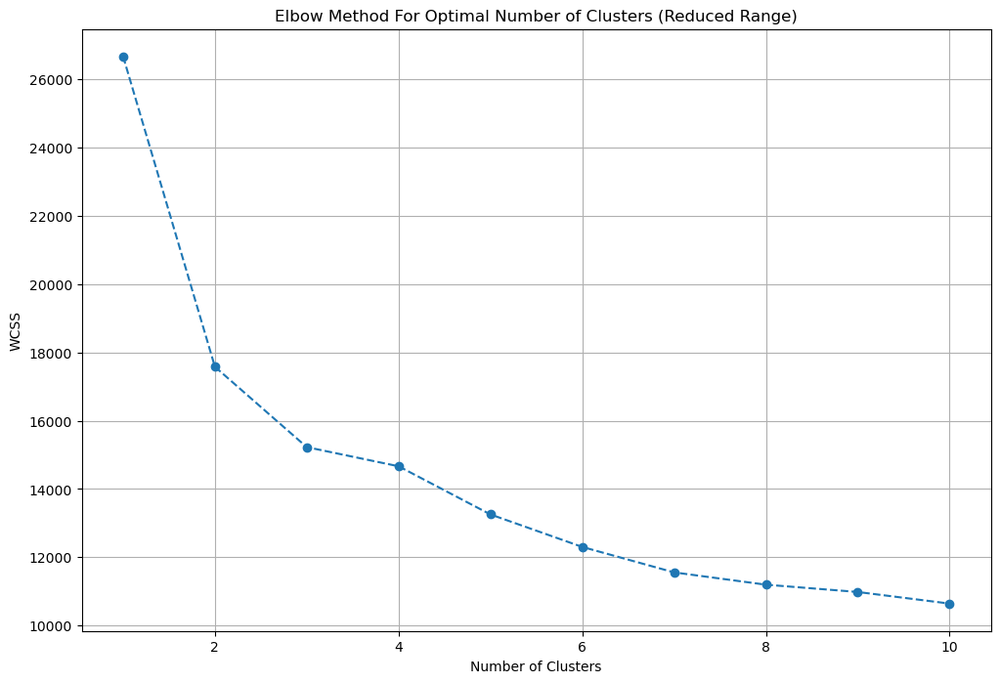

In [404]:
# Plot the results
plt.figure(figsize=(12, 8))
plt.plot(range(1,11), wcss_reduced, marker='o', linestyle='--')
plt.title('Elbow Method For Optimal Number of Clusters (Reduced Range)')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

In [405]:
# Only two clusters in data but we wanted to make three categories like luxury, semi-luxury, budget
# Lets introduce luxury score on the basis of each unique feature present
# From chatgpt we made scores of each feature

# Define the weights for each feature as provided
# Assigning weights based on perceived luxury contribution
weights = {
    '24/7 Power Backup': 8,
    '24/7 Water Supply': 4,
    '24x7 Security': 7,
    'ATM': 4,
    'Aerobics Centre': 6,
    'Airy Rooms': 8,
    'Amphitheatre': 7,
    'Badminton Court': 7,
    'Banquet Hall': 8,
    'Bar/Chill-Out Lounge': 9,
    'Barbecue': 7,
    'Basketball Court': 7,
    'Billiards': 7,
    'Bowling Alley': 8,
    'Business Lounge': 9,
    'CCTV Camera Security': 8,
    'Cafeteria': 6,
    'Car Parking': 6,
    'Card Room': 6,
    'Centrally Air Conditioned': 9,
    'Changing Area': 6,
    "Children's Play Area": 7,
    'Cigar Lounge': 9,
    'Clinic': 5,
    'Club House': 9,
    'Concierge Service': 9,
    'Conference room': 8,
    'Creche/Day care': 7,
    'Cricket Pitch': 7,
    'Doctor on Call': 6,
    'Earthquake Resistant': 5,
    'Entrance Lobby': 7,
    'False Ceiling Lighting': 6,
    'Feng Shui / Vaastu Compliant': 5,
    'Fire Fighting Systems': 8,
    'Fitness Centre / GYM': 8,
    'Flower Garden': 7,
    'Food Court': 6,
    'Foosball': 5,
    'Football': 7,
    'Fountain': 7,
    'Gated Community': 7,
    'Golf Course': 10,
    'Grocery Shop': 6,
    'Gymnasium': 8,
    'High Ceiling Height': 8,
    'High Speed Elevators': 8,
    'Infinity Pool': 9,
    'Intercom Facility': 7,
    'Internal Street Lights': 6,
    'Internet/wi-fi connectivity': 7,
    'Jacuzzi': 9,
    'Jogging Track': 7,
    'Landscape Garden': 8,
    'Laundry': 6,
    'Lawn Tennis Court': 8,
    'Library': 8,
    'Lounge': 8,
    'Low Density Society': 7,
    'Maintenance Staff': 6,
    'Manicured Garden': 7,
    'Medical Centre': 5,
    'Milk Booth': 4,
    'Mini Theatre': 9,
    'Multipurpose Court': 7,
    'Multipurpose Hall': 7,
    'Natural Light': 8,
    'Natural Pond': 7,
    'Park': 8,
    'Party Lawn': 8,
    'Piped Gas': 7,
    'Pool Table': 7,
    'Power Back up Lift': 8,
    'Private Garden / Terrace': 9,
    'Property Staff': 7,
    'RO System': 7,
    'Rain Water Harvesting': 7,
    'Reading Lounge': 8,
    'Restaurant': 8,
    'Salon': 8,
    'Sauna': 9,
    'Security / Fire Alarm': 9,
    'Security Personnel': 9,
    'Separate entry for servant room': 8,
    'Sewage Treatment Plant': 6,
    'Shopping Centre': 7,
    'Skating Rink': 7,
    'Solar Lighting': 6,
    'Solar Water Heating': 7,
    'Spa': 9,
    'Spacious Interiors': 9,
    'Squash Court': 8,
    'Steam Room': 9,
    'Sun Deck': 8,
    'Swimming Pool': 8,
    'Temple': 5,
    'Theatre': 9,
    'Toddler Pool': 7,
    'Valet Parking': 9,
    'Video Door Security': 9,
    'Visitor Parking': 7,
    'Water Softener Plant': 7,
    'Water Storage': 7,
    'Water purifier': 7,
    'Yoga/Meditation Area': 7
}
# Calculate luxury score for each row
luxury_score = features_binary_df[list(weights.keys())].multiply(list(weights.values())).sum(axis=1)


In [406]:
df['luxury_score'] = luxury_score

In [407]:
df.head()

,society,property_type,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area,study room,servant room,store room,puja room,others,Chimney,Microwave,Light,Washing Machine,AC,Dining Table,Fridge,Modular Kitchen,Curtains,Wardrobe,Fan,Bed,Exhaust Fan,Sofa,Geyser,Stove,Water Purifier,TV,furnishing_type,features_list,luxury_score
0,paras dews,flat,sector 106,1.20,11605.0,1034.0,Super Built up area 1665(154.68 sq.m.)Built Up area: 1145 sq.ft. (106.37 sq.m.)Carpet area: 1034 sq.ft. (96.06 sq.m.),3,3,3,study room,12.0,North-West,Relatively New,"['MG Road Metro Station', 'NeoSquare Shopping Mall', 'Dwarka Expressway', 'Glorious World School', 'DPG Institute of Technology', 'Chirag Hospital', 'Indira Gandhi International Airport', 'Gurgaon', 'Country Inn & Suites by Radisson', 'SkyJumper Trampoline Park', 'Hamoni Golf Camp']",NaN,"['Water purifier', 'Centrally Air Conditioned', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']",1665.0,1145.0,1034.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"[Water purifier, Centrally Air Conditioned, Security / Fire Alarm, Feng Shui / Vaastu Compliant, Private Garden / Terrace, Intercom Facility, Lift(s), High Ceiling Height, Maintenance Staff, False Ceiling Lighting, Water Storage, Separate entry for servant room, No open drainage around, Bank Attached Property, Piped-gas, Internet/wi-fi connectivity, Recently Renovated, Visitor Parking, Swimming Pool, Park, Security Personnel, Natural Light, Airy Rooms, Waste Disposal, Rain Water Harvesting, Water softening plant, Shopping Centre, Fitness Centre / GYM, Club house / Community Center]",158
1,railway officers rpf society,flat,sector 9a,1.25,6921.0,1806.0,Carpet area: 1806 (167.78 sq.m.),4,3,3,servant room,1.0,NaN,Old Property,"['Chintapurni Mandir', 'State bank ATM', 'Esic Hospital Gurugram', 'Shree Krishna Hospital Gurgaon', 'Shri Multispeciality Hospital', 'Kr Dental Hub', 'Prateek Nursing Home And Polyclinic', 'Dr. Hitesh Dawar', 'Dr. Ashok Jain', 'Pearl Dental Clinic', 'Taneja Hospital', 'Jain Sant Phool Chand Ji Charitable Hospital', 'Sarvodya Hospital', 'Sneh Hospital Gurgaon', 'Dr. Madan Clinic', 'Bhardwaj Hospital', 'Ankur Clinic and Maternity Home', 'Gurgaon Eye Centre', 'Dev Man Kathuria Clinic', 'Geeta Nursing Home Gurgaon', 'Navjeevan Hospital and Maternity Centre', 'Shiv Mahima Patient Care Bureau', 'Aryan Hospital', 'Chiranjiv Hospital', 'Kamla Hospital Gurgaon', 'Satyam Hospital Gurgaon', 'Shri Gobind Hospital', 'Dr. Sindhu Clinic', 'Swastik Maternity and Medical Centre', 'D.R. Rajnis Gupta Clinic', 'Lal Superspeciality Hospital', 'Ravi Clinic and Health Care Centre', 'Mangalam Hospital and Heart Centre Gurgaon', 'R K Hospital Gurgaon', 'Indian bank', 'Kotak bank', 'Hdfc bank', 'State bank of india', 'Pizza Hut', 'St. Michaels Sr. Sec. School', 'Basai dhankot railway station', 'Gurgaon railway station', 'Gurgaon railway station', 'Gurgaon railway station']","['3 Wardrobe', '3 Geyser', '1 Modular Kitchen', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Lift(s)', 'Park', 'Visitor Parking', 'Natural Light', 'Airy Rooms', 'Spacious Interiors']",NaN,NaN,1806.0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,3,0,

In [408]:
# Dropping irrelevant column
# Will remove areawithtype also but after missing value imputation

# cols to drop -> nearbyLocations,furnishDetails, features,features_list, additionalRoom
df.drop(columns=['nearbyLocations','furnishDetails','features','features_list','additionalRoom'],inplace=True)

In [409]:
df.sample(5)

,society,property_type,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,study room,servant room,store room,puja room,others,Chimney,Microwave,Light,Washing Machine,AC,Dining Table,Fridge,Modular Kitchen,Curtains,Wardrobe,Fan,Bed,Exhaust Fan,Sofa,Geyser,Stove,Water Purifier,TV,furnishing_type,luxury_score
881,adani m2k oyster grande,flat,sector 102,2.50,7817.0,3198.0,Super Built up area 3198(297.1 sq.m.)Built Up area: 2600 sq.ft. (241.55 sq.m.)Carpet area: 2350 sq.ft. (218.32 sq.m.),4,5,3+,10.0,North-East,Relatively New,3198.0,2600.0,2350.0,0,1,0,0,0,1,0,5,0,6,0,0,1,0,0,6,0,1,0,0,1,0,0,1,174
2781,vatika india next,house,sector 83,1.70,7870.0,2160.0,Plot area 240(200.67 sq.m.),3,3,3+,4.0,North-West,New Property,NaN,2160.0,NaN,0,1,0,0,0,0,0,4,0,0,0,0,0,0,4,5,0,0,0,3,0,0,0,0,0
3105,independent,house,sector 12,6.00,315789.0,190.0,Plot area 190(17.65 sq.m.)Carpet area: 1600 sq.ft. (148.64 sq.m.),9,6,2,2.0,North-East,Old Property,NaN,NaN,1600.0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1418,smart world orchard,flat,sector 61,2.24,14460.0,1549.0,Super Built up area 1549(143.91 sq.m.),3,3,2,3.0,NaN,New Property,1549.0,NaN,NaN,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,61
124,orris aster court premier,flat,sector 85,1.45,6839.0,2120.0,Super Built up area 2120(196.95 sq.m.)Built Up area: 1616 sq.ft. (150.13 sq.m.),3,4,2,3.0,North,New Property,2120.0,1616.0,NaN,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,16


In [410]:
df.shape

(3803, 41)

In [411]:
df.to_csv('data_after_feature_engg.csv',index=False)

In [495]:
df.sample(5)

,society,property_type,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,study room,servant room,store room,puja room,others,Chimney,Microwave,Light,Washing Machine,AC,Dining Table,Fridge,Modular Kitchen,Curtains,Wardrobe,Fan,Bed,Exhaust Fan,Sofa,Geyser,Stove,Water Purifier,TV,furnishing_type,luxury_score
2767,emaar palm gardens,flat,sector 83,1.38,8023.0,1720.0,Super Built up area 1720(159.79 sq.m.)Built Up area: 1350 sq.ft. (125.42 sq.m.)Carpet area: 1150 sq.ft. (106.84 sq.m.),3,3,3,5.0,South-West,Relatively New,1720.0,1350.0,1150.0,0,1,0,0,0,1,0,5,0,0,0,0,1,0,3,5,0,1,0,2,0,0,0,1,8
2328,luxury dlf city floors,house,sector 26,8.25,45833.0,1800.0,Plot area 200(167.23 sq.m.),12,12,3+,4.0,North,New Property,NaN,1800.0,NaN,0,1,0,0,0,1,0,40,0,12,0,0,1,0,12,20,0,1,0,12,0,0,0,1,105
1366,vipul tatvam villa,house,sector 48,7.25,201388.0,360.0,Plot area 360(33.45 sq.m.),4,4,3,2.0,NaN,Relatively New,NaN,360.0,NaN,1,1,1,0,0,0,0,9,0,6,0,0,1,0,5,4,0,1,0,5,0,1,0,1,103
500,ss,flat,sector 85,1.18,7170.0,1646.0,Super Built up area 1640(152.36 sq.m.)Built Up area: 1630 sq.ft. (151.43 sq.m.)Carpet area: 1620 sq.ft. (150.5 sq.m.),2,2,3,4.0,West,Relatively New,1640.0,1630.0,1620.0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,49
1573,independent,house,sohna road road,1.50,14245.0,1053.0,Plot area 117(97.83 sq.m.),2,3,2,1.0,North,New Property,NaN,1053.0,NaN,1,0,0,0,0,1,0,40,0,3,0,0,1,3,2,6,0,0,0,3,0,0,0,1,69
